<a href="https://colab.research.google.com/github/iamstuti/Face-Mask-Detection-using-Detectron2-and-Faster-RCNN/blob/main/Face_mask_detection_using_Detectron2_and_Faster_RCNN.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>


**Using Roboflow for Dataset preparation**

Specifically, you can use Roboflow to:


*   Store and organize your image data.
*   Annotate images (with the helping hand of machine learning models)
*   Convert between dozens of different annotation formats.
*   Understand and assess the quality of your datasets.
*   Process and augment your images to help your models train faster and generalize better.
*   Version control datasets and share them with your team.
*   Train a model with a single click or train your own models outside of Roboflow.
*   Create an infinitely scalable API to get predictions from your trained model.
*   Deploy to edge devices like the NVIDIA Jetson.
*   Run inference in customers' web browsers with WebGL.
*   Continually improve your models over time with active learning.


Refer the roboflow getting started [blog](https://blog.roboflow.com/getting-started-with-roboflow/) for more information

This project takes the [Face Mask Detection dataset](https://www.kaggle.com/andrewmvd/face-mask-detection) and uses Roboflow to  select a train/test split for your images; the default of 70% training, 20% validation, and 10% testing is usually a safe bet, adding augmentation of random noise of about (5%). Other settings remains as they were: auto-orient and resize 416x416. To better understand these options, refer to the [documentation](https://docs.roboflow.com/). Finally, our new dataset of face mask detection is exported into the COCO Format.









Detectron2 is a research platform and a production library for object detection, built by Facebook AI Research (FAIR).

It is completely written on PyTorch and is flexible and extensible, and able to provide fast training on single or multiple GPU servers.

Also, it includes high-quality implementations of state-of-the-art object detection algorithms, including DensePose , panoptic feature pyramid networks , and numerous variants of the pioneering Mask R-CNN model family also developed by FAIR.

Its extensible design makes it easy to implement cutting-edge research projects without having to fork the entire codebase.

In this notebook, we are going to deal with identifying people with masks and without face masks using the Faster RCNN model from the Detectron 2's model zoo.
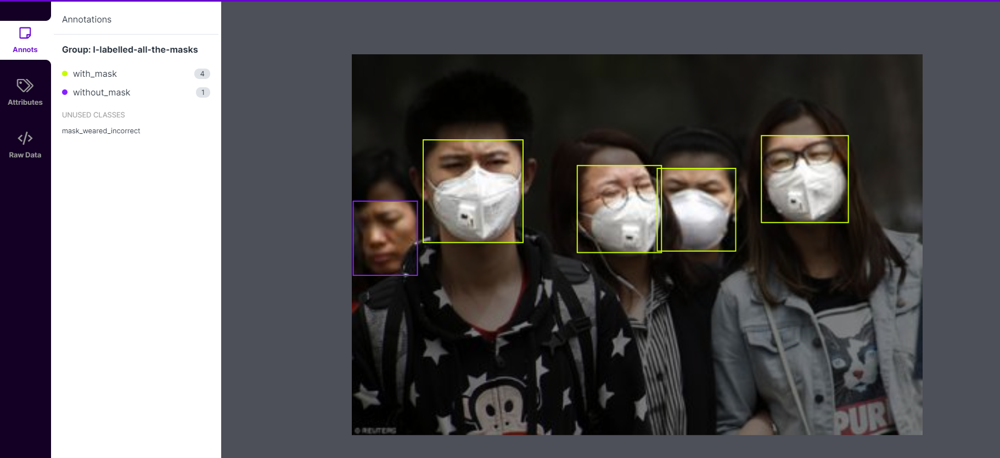

We identify faces with masks and without masks and we include a Single Class called Others for people wearing face masks incorrectly.

Object Detection

Locate the presence of objects with a bounding box and types or classes of the located objects in an image.

Input: An image with one or more objects, such as a photograph.

Output: One or more bounding boxes (e.g. defined by a point, width, and height), and a class label for each bounding box.


In [ ]:
!curl -L "https://app.roboflow.com/ds/ZaLAPNR47c?key=RRymz3sf6O" > roboflow.zip; unzip roboflow.zip; rm roboflow.zip


  % Total    % Received % Xferd  Average Speed   Time    Time     Time  Current
                                 Dload  Upload   Total   Spent    Left  Speed
100   887  100   887    0     0   1828      0 --:--:-- --:--:-- --:--:--  1825
100 58.3M  100 58.3M    0     0  42.9M      0  0:00:01  0:00:01 --:--:--  313M
Archive:  roboflow.zip
 extracting: README.roboflow.txt     
   creating: test/
 extracting: test/_annotations.coco.json  
 extracting: test/maksssksksss0_png.rf.969d80d661473577ef5675a66ef9e29c.jpg  
 extracting: test/maksssksksss101_png.rf.d1a3ab99f42fc1e71195ad4153ff2b71.jpg  
 extracting: test/maksssksksss114_png.rf.9eb40ab74931a6e334ebf0514688a666.jpg  
 extracting: test/maksssksksss119_png.rf.301eb48ff6cdc0b1b5de38c5a06311a5.jpg  
 extracting: test/maksssksksss132_png.rf.d51aeea45bb2342ae1891c955bc7e0c2.jpg  
 extracting: test/maksssksksss143_png.rf.522dc0e7e210a9ed1aa873e23f4d1b5c.jpg  
 extracting: test/maksssksksss159_png.rf.8f1ab481dd65b516a24ad2ab18aaee9c.jpg  
 ex

 ## **Convolutional Neural Networks**


**Deep Neural Networks**: Traditional Neural Networks are string of neurons connected together. 

It has the: Input layer, Hidden Layers, Output layer.

The input flows from the Input layer to the Output layer through the hidden layers.

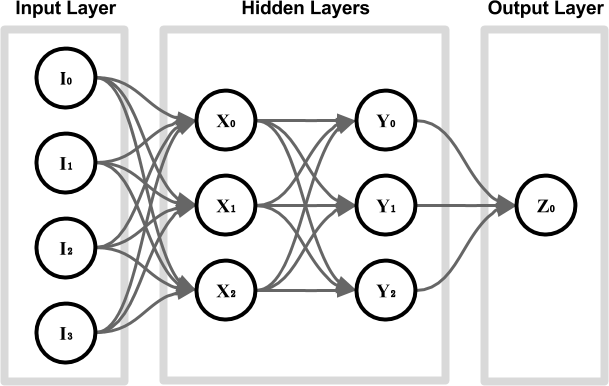

**Kernel Convolution**: A process where we take a small grid of numbers & pass them over the whole image transforming it. By using different numbers we can form blurs, edge detection, sharpen etc.,

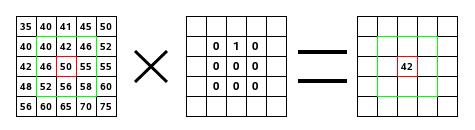

**Convolutional Neural Networks**
CNN's combine traditional Neural Networks and Convolutions.

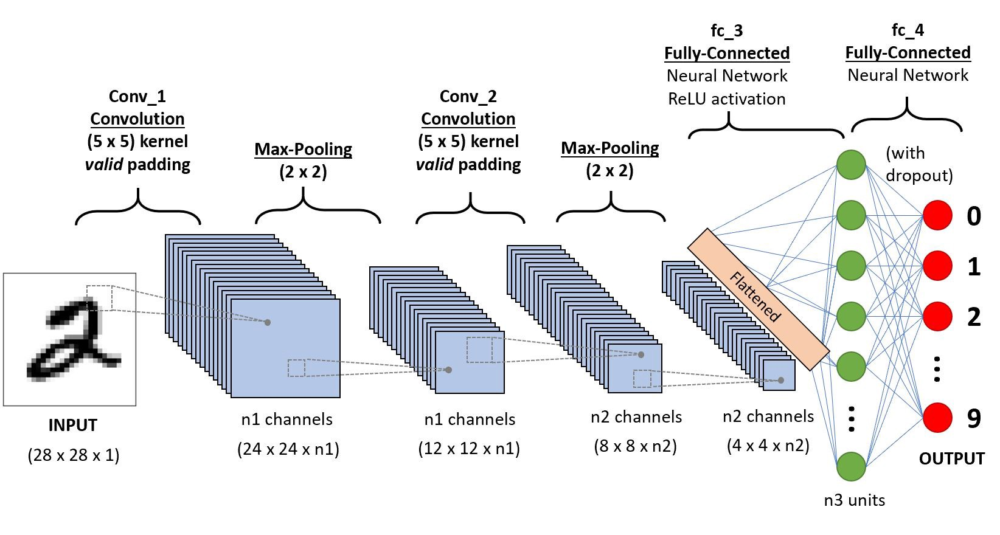

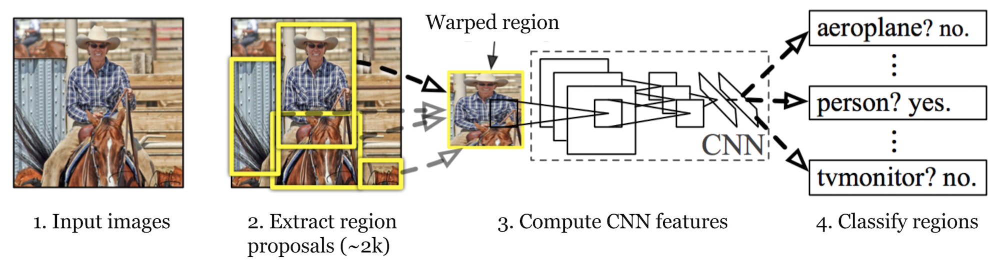




### **RCNN**

Above diagram, shows how RCNN works. 

R-CNN (Girshick et al., 2014) is short for “Region-based Convolutional Neural Networks”. The main idea is composed of two steps. First, using selective search, it identifies a manageable number of bounding-box object region candidates (“region of interest” or “RoI”). And then it extracts CNN features from each region independently for classification

### **Install Dependencies**

Kickstart with installing a few dependencies such as Torch Vision and COCO API and check whether Cuda is available. Cuda helps in keeping track of the currently selected GPU.

In [ ]:
# install dependencies: 
!pip install pyyaml==5.1
import torch, torchvision
print(torch.__version__, torch.cuda.is_available())
!gcc --version
# opencv is pre-installed on colab

     |████████████████████████████████| 276kB 9.2MB/s 
  Created wheel for pyyaml: filename=PyYAML-5.1-cp37-cp37m-linux_x86_64.whl size=44091 sha256=7d32c5ef803dd712e8f0266a0acf05f3ad57b25d236f7a620d70cc58af700882
  Stored in directory: /root/.cache/pip/wheels/ad/56/bc/1522f864feb2a358ea6f1a92b4798d69ac783a28e80567a18b
Successfully built pyyaml
  Found existing installation: PyYAML 3.13
    Uninstalling PyYAML-3.13:
      Successfully uninstalled PyYAML-3.13
1.8.1+cu101 True
gcc (Ubuntu 7.5.0-3ubuntu1~18.04) 7.5.0
Copyright (C) 2017 Free Software Foundation, Inc.
This is free software; see the source for copying conditions.  There is NO
warranty; not even for MERCHANTABILITY or FITNESS FOR A PARTICULAR PURPOSE.



### **Install Detectron2**

 And then install Detectron2

In [ ]:
!pip install detectron2 -f https://dl.fbaipublicfiles.com/detectron2/wheels/cu101/torch1.8/index.html

Looking in links: https://dl.fbaipublicfiles.com/detectron2/wheels/cu101/torch1.8/index.html
     |████████████████████████████████| 6.2MB 6.3MB/s 
     |████████████████████████████████| 81kB 5.9MB/s 
     |████████████████████████████████| 51kB 7.9MB/s 
     |████████████████████████████████| 112kB 17.1MB/s 
  Created wheel for fvcore: filename=fvcore-0.1.3.post20210317-cp37-none-any.whl size=58543 sha256=b7916c6941ec8eca39c46c0e75fda27822abb32c32da0ffad69bb18a4f95b930
  Stored in directory: /root/.cache/pip/wheels/d2/ee/3a/5c531df777c03d8c67f22c65f97d6f75321087482d05a9b218
  Created wheel for antlr4-python3-runtime: filename=antlr4_python3_runtime-4.8-cp37-none-any.whl size=141231 sha256=a5dba3a1ffd9f7c5b4c1674c5f3f9fd54b5d23f396ea3d33cca1ad0c892af09e
  Stored in directory: /root/.cache/pip/wheels/e3/e2/fa/b78480b448b8579ddf393bebd3f47ee23aa84c89b6a78285c8
Successfully built fvcore antlr4-python3-runtime


Import a few necessary packages.

In [ ]:
import detectron2
from detectron2.utils.logger import setup_logger
setup_logger()

# import some common libraries
import numpy as np
import cv2
import random
from google.colab.patches import cv2_imshow

# import some common detectron2 utilities
from detectron2 import model_zoo
from detectron2.engine import DefaultPredictor
from detectron2.config import get_cfg
from detectron2.utils.visualizer import Visualizer
from detectron2.data import MetadataCatalog
from detectron2.data.catalog import DatasetCatalog

## **Preparing and registering the Dataset**


**DatasetCatalog**

To let detectron2 know how to obtain a dataset named “my_dataset”, users need to implement a function that returns the items in your dataset and then tell detectron2 about this function by using the method register.

**Metadata for a Dataset**

Each dataset is associated with some metadata, accessible through MetadataCatalog.get(dataset_name).some_metadata. 

- Metadata is a key-value mapping that contains information that’s shared among the entire dataset, and usually is used to interpret what’s in the dataset, e.g., names of classes, colors of classes, root of files, etc. 
- This information will be useful for augmentation, evaluation, visualization, logging, etc. The structure of metadata depends on what is needed from the corresponding downstream code.



If your dataset is in COCO format, this cell can be replaced by the following three lines:

```
from detectron2.data.datasets import register_coco_instances
register_coco_instances("my_dataset_train", {}, "json_annotation_train.json", "path/to/image/dir")
register_coco_instances("my_dataset_val", {}, "json_annotation_val.json", "path/to/image/dir")
```





In [ ]:
from detectron2.data.datasets import register_coco_instances
register_coco_instances("my_dataset_train", {}, "/content/train/_annotations.coco.json", "/content/train")
register_coco_instances("my_dataset_val", {}, "/content/valid/_annotations.coco.json", "/content/valid")
register_coco_instances("my_dataset_test", {}, "/content/test/_annotations.coco.json", "/content/test")


### **Visualizing the Training Dataset**

We'll now try to visualize the training dataset. We'll randomly pick 3 pictures from the train folder of our dataset and see how the bounding boxes look like.

**Visualizer**

Visualizer that draws data about detection/segmentation on images.

It contains methods like `draw_{text,box,circle,line,binary_mask,polygon}`
that draw primitive objects to images, as well as high-level wrappers like
`draw_{instance_predictions,sem_seg,panoptic_seg_predictions,dataset_dict}`
that draw composite data in some pre-defined style.

WARNING [06/14 05:24:25 d2.data.datasets.coco]: 
Category ids in annotations are not in [1, #categories]! We'll apply a mapping for you.

[06/14 05:24:25 d2.data.datasets.coco]: Loaded 1186 images in COCO format from /content/train/_annotations.coco.json


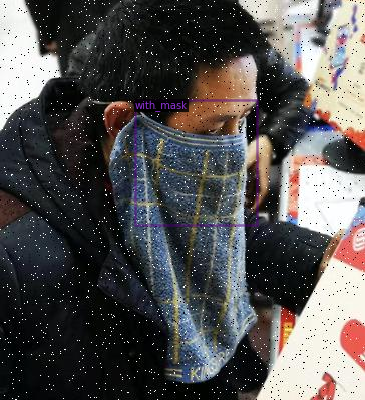

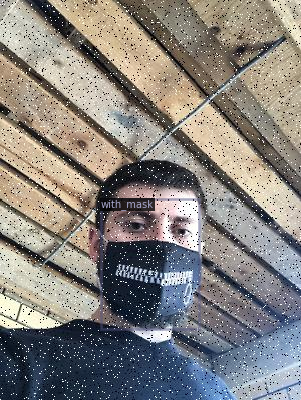

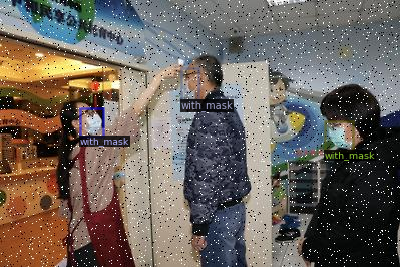

In [ ]:
#visualize training data
my_dataset_train_metadata = MetadataCatalog.get("my_dataset_train")
dataset_dicts = DatasetCatalog.get("my_dataset_train")

import random
from detectron2.utils.visualizer import Visualizer

for d in random.sample(dataset_dicts, 3):
    img = cv2.imread(d["file_name"])
    visualizer = Visualizer(img[:, :, ::-1], metadata=my_dataset_train_metadata)
    vis = visualizer.draw_dataset_dict(d)
    cv2_imshow(vis.get_image()[:, :, ::-1])

### **Training the Faster R-CNN Model**

We now have a custom model and a data loader. To run training, users typically have a preference in one of the following **two** styles:

**Custom Training Loop**

With a model and a data loader ready, everything else needed to write a training loop can be found in PyTorch, and you are free to write the training loop yourself. This style allows researchers to manage the entire training logic more clearly and have full control. One such example is provided in tools/plain_train_net.py.

Any customization on the training logic is then easily controlled by the user.

**Trainer Abstraction**

We also provide a standarized “trainer” abstraction with a hook system that helps simplify the standard training behavior. It includes the following two instantiations:


- **SimpleTrainer** provides a minimal training loop for single-cost single-optimizer single-data-source training, with nothing else. Other tasks (checkpointing, logging, etc) can be implemented using the hook system.


- **DefaultTrainer** is a SimpleTrainer initialized from a config, used by tools/train_net.py and many scripts. It includes more standard default behaviors that one might want to opt in, including default configurations for optimizer, learning rate schedule, logging, evaluation, checkpointing etc.


**To customize a DefaultTrainer:**


For simple customizations (e.g. change optimizer, evaluator, LR scheduler, data loader, etc.), overwrite its methods in a subclass.

We will look at an example of changing the evaluator.

**Hook System**

For extra tasks during training, check the hook system to see if it’s supported.

As an example, to print hello during training:


class HelloHook(HookBase):
  def after_step(self):
    if self.trainer.iter % 100 == 0:
      print(f"Hello at iteration {self.trainer.iter}!")


Using a trainer+hook system means there will always be some non-standard behaviors that cannot be supported, especially in research. For this reason, we intentionally keep the trainer & hook system minimal, rather than powerful. If anything cannot be achieved by such a system, it’s easier to start from tools/plain_train_net.py to implement custom training logic manually.

In [ ]:
from detectron2.engine import DefaultTrainer
from detectron2.evaluation import COCOEvaluator

class CocoTrainer(DefaultTrainer):

  @classmethod
  def build_evaluator(cls, cfg, dataset_name, output_folder=None):

    if output_folder is None:
        os.makedirs("coco_eval", exist_ok=True)
        output_folder = "coco_eval"

    return COCOEvaluator(dataset_name, cfg, False, output_folder)

This is the step where we set the configuration for training. Everything related to hyperparameters and parameters related to normalization must be defined here.

**Learning Rate**   
Specifically, the learning rate is a configurable hyperparameter used in the training of neural networks that has a small positive value, often in the range between 0.0 and 1.0. The learning rate controls how quickly the model is adapted to the problem.


**Iteration** is one time processing for forward and backward for a batch of images (say one batch is defined as 16, then 16 images are processed in one iteration). 

**Epoch** is once all images are processed one time individually of forward and backward to the network, then that is one epoch.

**ROI_HEADS - BATCH_SIZE_PER_IMAGE** parameter is used to sample a subset of proposals coming out of RPN (Region Proposed Network) to calculate cls and reg loss during training. Calculating loss on all RPN proposals isn't computationally efficient.

**Evaluation Period** 
To set the number of iterations to perform evaluation on the cfg.DATASETS.TEST, which should be our Validation set.

For example: Setting EVAL_PERIOD = 100, This will do evaluation once after 100 iterations on the cfg.DATASETS.TEST, which should be our Validation set.


We use the **"faster_rcnn_R_50_FPN_3x.yaml"** model from the model zoo of the Detectron2.

In [ ]:
from detectron2.config import get_cfg
#from detectron2.evaluation.coco_evaluation import COCOEvaluator
import os

cfg = get_cfg()
cfg.merge_from_file(model_zoo.get_config_file("COCO-Detection/faster_rcnn_R_50_FPN_3x.yaml"))
cfg.DATASETS.TRAIN = ("my_dataset_train",)
cfg.DATASETS.TEST = ("my_dataset_val",)

cfg.DATALOADER.NUM_WORKERS = 4
cfg.MODEL.WEIGHTS = model_zoo.get_checkpoint_url("COCO-Detection/faster_rcnn_R_50_FPN_3x.yaml")
cfg.SOLVER.IMS_PER_BATCH =4
cfg.SOLVER.BASE_LR = 0.0125
cfg.SOLVER.MAX_ITER = 1500
cfg.MODEL.ROI_HEADS.BATCH_SIZE_PER_IMAGE = 256
cfg.MODEL.ROI_HEADS.NUM_CLASSES =3
cfg.TEST.EVAL_PERIOD = 500
os.makedirs(cfg.OUTPUT_DIR, exist_ok =True)

trainer = CocoTrainer(cfg)
trainer.resume_or_load(resume=False)
trainer.train()

[06/14 05:24:37 d2.engine.defaults]: Model:
GeneralizedRCNN(
  (backbone): FPN(
    (fpn_lateral2): Conv2d(256, 256, kernel_size=(1, 1), stride=(1, 1))
    (fpn_output2): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (fpn_lateral3): Conv2d(512, 256, kernel_size=(1, 1), stride=(1, 1))
    (fpn_output3): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (fpn_lateral4): Conv2d(1024, 256, kernel_size=(1, 1), stride=(1, 1))
    (fpn_output4): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (fpn_lateral5): Conv2d(2048, 256, kernel_size=(1, 1), stride=(1, 1))
    (fpn_output5): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (top_block): LastLevelMaxPool()
    (bottom_up): ResNet(
      (stem): BasicStem(
        (conv1): Conv2d(
          3, 64, kernel_size=(7, 7), stride=(2, 2), padding=(3, 3), bias=False
          (norm): FrozenBatchNorm2d(num_features=64, eps=1e-05)
        )
      )
      (res

/usr/local/lib/python3.7/dist-packages/torch/utils/data/dataloader.py:477: UserWarning: This DataLoader will create 4 worker processes in total. Our suggested max number of worker in current system is 2, which is smaller than what this DataLoader is going to create. Please be aware that excessive worker creation might get DataLoader running slow or even freeze, lower the worker number to avoid potential slowness/freeze if necessary.
  cpuset_checked))
model_final_280758.pkl: 167MB [00:02, 58.2MB/s]                           
Skip loading parameter 'roi_heads.box_predictor.cls_score.weight' to the model due to incompatible shapes: (81, 1024) in the checkpoint but (4, 1024) in the model! You might want to double check if this is expected.
Skip loading parameter 'roi_heads.box_predictor.cls_score.bias' to the model due to incompatible shapes: (81,) in the checkpoint but (4,) in the model! You might want to double check if this is expected.
Skip loading parameter 'roi_heads.box_predictor.b

[06/14 05:24:42 d2.engine.train_loop]: Starting training from iteration 0


/usr/local/lib/python3.7/dist-packages/torch/utils/data/dataloader.py:477: UserWarning: This DataLoader will create 4 worker processes in total. Our suggested max number of worker in current system is 2, which is smaller than what this DataLoader is going to create. Please be aware that excessive worker creation might get DataLoader running slow or even freeze, lower the worker number to avoid potential slowness/freeze if necessary.
  cpuset_checked))


[06/14 05:25:01 d2.utils.events]:  eta: 0:23:34  iter: 19  total_loss: 1.657  loss_cls: 1.164  loss_box_reg: 0.2276  loss_rpn_cls: 0.1269  loss_rpn_loc: 0.05036  time: 0.9167  data_time: 0.0382  lr: 0.00024976  max_mem: 4961M
[06/14 05:25:20 d2.utils.events]:  eta: 0:23:31  iter: 39  total_loss: 0.8817  loss_cls: 0.4034  loss_box_reg: 0.4004  loss_rpn_cls: 0.03556  loss_rpn_loc: 0.02881  time: 0.9335  data_time: 0.0207  lr: 0.00049951  max_mem: 4961M
[06/14 05:25:40 d2.utils.events]:  eta: 0:23:42  iter: 59  total_loss: 0.9128  loss_cls: 0.3078  loss_box_reg: 0.4791  loss_rpn_cls: 0.04216  loss_rpn_loc: 0.03968  time: 0.9543  data_time: 0.0220  lr: 0.00074926  max_mem: 4961M
[06/14 05:26:00 d2.utils.events]:  eta: 0:23:34  iter: 79  total_loss: 0.8353  loss_cls: 0.2245  loss_box_reg: 0.486  loss_rpn_cls: 0.03016  loss_rpn_loc: 0.03794  time: 0.9706  data_time: 0.0227  lr: 0.00099901  max_mem: 4961M
[06/14 05:26:21 d2.utils.events]:  eta: 0:23:19  iter: 99  total_loss: 0.463  loss_cls: 

## **Inference from the Validation Dataset using the trained model**

In [ ]:
# Look at training curves in tensorboard:
%load_ext tensorboard
%tensorboard --logdir output

<IPython.core.display.Javascript object>

 An output folder gets saved in the local storage in which the final weights are stored. You can save this folder for inferencing from this model in future.

Set the score threshold value for reducing the redundant boxes on the prediction results.

**Default Predictor**

Create a simple end-to-end predictor with the given config that runs on single device for a single input image.

## **Evaluating the model**

In [ ]:
from detectron2.data import DatasetCatalog, MetadataCatalog, build_detection_test_loader
from detectron2.evaluation import COCOEvaluator, inference_on_dataset

cfg.MODEL.WEIGHTS = os.path.join(cfg.OUTPUT_DIR, "model_final.pth")
cfg.MODEL.ROI_HEADS.SCORE_THRESH_TEST = 0.85
predictor = DefaultPredictor(cfg)
evaluator = COCOEvaluator("my_dataset_test", cfg, False, output_dir="./output/")
val_loader = build_detection_test_loader(cfg, "my_dataset_test")
inference_on_dataset(trainer.model, val_loader, evaluator)

WARNING [06/14 05:51:41 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprecated behavior. Please pass in explicit arguments instead.
WARNING [06/14 05:51:41 d2.data.datasets.coco]: 
Category ids in annotations are not in [1, #categories]! We'll apply a mapping for you.

[06/14 05:51:41 d2.data.datasets.coco]: Loaded 85 images in COCO format from /content/test/_annotations.coco.json
[06/14 05:51:41 d2.data.build]: Distribution of instances among all 4 categories:
|   category    | #instances   |   category    | #instances   |  category  | #instances   |
|:-------------:|:-------------|:-------------:|:-------------|:----------:|:-------------|
| I-labelled-.. | 0            | mask_weared.. | 15           | with_mask  | 329          |
| without_mask  | 61           |               |              |            |              |
|     total     | 405          |               |              |            |              |
[06/14 05:51:41 d2.data.dataset_mapp

/usr/local/lib/python3.7/dist-packages/torch/utils/data/dataloader.py:477: UserWarning: This DataLoader will create 4 worker processes in total. Our suggested max number of worker in current system is 2, which is smaller than what this DataLoader is going to create. Please be aware that excessive worker creation might get DataLoader running slow or even freeze, lower the worker number to avoid potential slowness/freeze if necessary.
  cpuset_checked))


[06/14 05:51:43 d2.evaluation.evaluator]: Inference done 11/85. 0.1140 s / img. ETA=0:00:08
[06/14 05:51:48 d2.evaluation.evaluator]: Inference done 54/85. 0.1145 s / img. ETA=0:00:03
[06/14 05:51:52 d2.evaluation.evaluator]: Total inference time: 0:00:09.479169 (0.118490 s / img per device, on 1 devices)
[06/14 05:51:52 d2.evaluation.evaluator]: Total inference pure compute time: 0:00:09 (0.115085 s / img per device, on 1 devices)
[06/14 05:51:52 d2.evaluation.coco_evaluation]: Preparing results for COCO format ...
[06/14 05:51:52 d2.evaluation.coco_evaluation]: Saving results to ./output/coco_instances_results.json
[06/14 05:51:52 d2.evaluation.coco_evaluation]: Evaluating predictions with unofficial COCO API...
Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
[06/14 05:51:52 d2.evaluation.fast_eval_api]: Evaluate annotation type *bbox*
[06/14 05:51:52 d2.evaluation.fast_eval_api]: COCOeval_opt.evaluate() finished in 0.02 seconds.
[06/14 05:51:52 d2.ev

OrderedDict([('bbox',
              {'AP': 31.74941356384337,
               'AP-I-labelled-all-the-masks': nan,
               'AP-mask_weared_incorrect': 44.77640246549519,
               'AP-with_mask': 50.471838226034926,
               'AP-without_mask': 0.0,
               'AP50': 50.15974718118652,
               'AP75': 34.61950079161251,
               'APl': 53.29005318114229,
               'APm': 40.237946705947,
               'APs': 23.487465265473297})])

In [ ]:
cfg.MODEL.WEIGHTS = os.path.join(cfg.OUTPUT_DIR, "model_final.pth")
cfg.DATASETS.TEST = ("my_dataset_test", )
cfg.MODEL.ROI_HEADS.SCORE_THRESH_TEST = 0.7   # set the testing threshold for this model
predictor = DefaultPredictor(cfg)
test_metadata = MetadataCatalog.get("my_dataset_test")

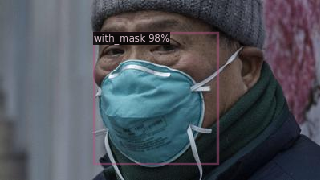

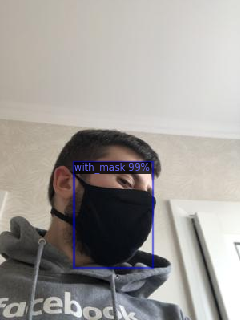

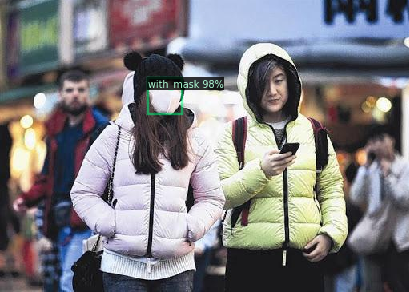

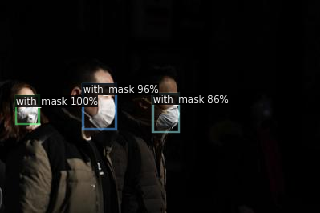

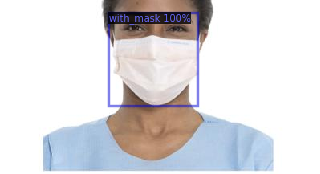

...

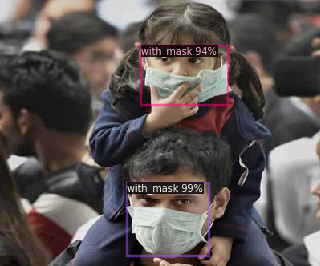

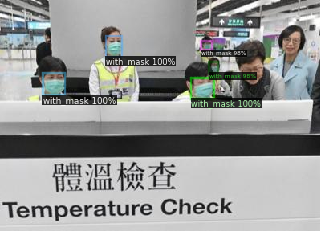

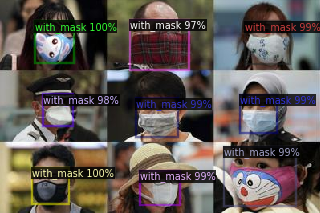

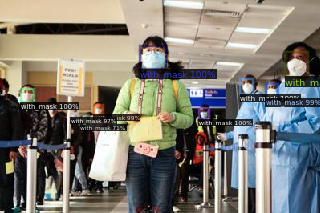

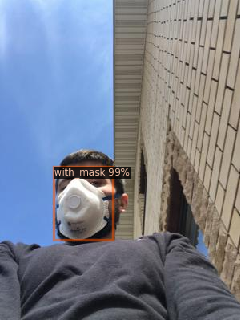

In [ ]:
from detectron2.utils.visualizer import ColorMode
import glob

for imageName in glob.glob('/content/test/*jpg'):
  im = cv2.imread(imageName)
  outputs = predictor(im)
  v = Visualizer(im[:, :, ::-1],
                metadata=test_metadata, 
                scale=0.8
                 )
  out = v.draw_instance_predictions(outputs["instances"].to("cpu"))
  cv2_imshow(out.get_image()[:, :, ::-1])


In [ ]:
# Look at training curves in tensorboard:
%load_ext tensorboard
%tensorboard --logdir output

The tensorboard extension is already loaded. To reload it, use:
  %reload_ext tensorboard


Reusing TensorBoard on port 6006 (pid 517), started 0:10:35 ago. (Use '!kill 517' to kill it.)

<IPython.core.display.Javascript object>